In [241]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

"""
Column 1: Time in seconds starting from 0 rounded to the closest 0.025s
Column 2: Acceleration reading in G for frontal axis
Column 3: Acceleration reading in G for vertical axis
Column 4: Acceleration reading in G for lateral axis
Column 5: Id of antenna reading sensor
Column 6: Received signal strength indicator (RSSI) 
Column 7: Phase
Column 8: Frequency
Column 9: Label of activity, 1: sit on bed, 2: sit on chair, 3: lying, 4: ambulating
"""
column_names = ['Time', 'Frontal Accel', 'Vertical Accel', 'Lateral Accel', 'Antenna ID', 'RSSI', 'Phase', 'Frequency', 'Activity Label']

# Extract Data From Files To DataFrames
root_dir = '/Users/chrisgerlach/Programming/MIDILab/LongitudinalAlgorithmDevelopment/Activity_Recognition/'
dataset_folder_names = ['S1_Dataset', 'S2_Dataset']

all_patient_files = {}  # Dictionary Of All Patient Files Separated By Dataset Folders
for dataset_folder_name in dataset_folder_names:
    dir_path = os.path.join(root_dir, dataset_folder_name)
    dir_files = os.listdir(dir_path)
    dir_files.remove('README.txt')

    dir_patient_files = {}  # Dictionary For Each Dataset Folder
    for file_name in dir_files:  # 
        file_path = os.path.join(dir_path, file_name)
        file = pd.read_csv(file_path, names=column_names)
        dir_patient_files[file_name] = file

    all_patient_files[dataset_folder_name] = dir_patient_files

# Dictionary Of All Patient Files
data_frames = {**all_patient_files['S1_Dataset'], **all_patient_files['S2_Dataset']}


In [242]:
import pandas as pd
import os

column_names = ['Time', 'Frontal Accel', 'Vertical Accel', 'Lateral Accel', 'Antenna ID', 'RSSI', 'Phase', 'Frequency', 'Activity Label']
root_dir = '/Users/chrisgerlach/Programming/MIDILab/LongitudinalAlgorithmDevelopment/Activity_Recognition/'
dataset_folder_names = ['S1_Dataset', 'S2_Dataset']

# Combine all data frames with patient ID and gender
data_frames = []
for dataset_folder_name in dataset_folder_names:
    dir_path = os.path.join(root_dir, dataset_folder_name)
    dir_files = os.listdir(dir_path)
    if 'README.txt' in dir_files:
        dir_files.remove('README.txt')

    for file_name in dir_files:
        file_path = os.path.join(dir_path, file_name)
        patient_ID = file_name.split('p')[1][0:2]  # Extract patient ID
        gender = file_name.split('p')[1][2]  # Extract gender
        file_df = pd.read_csv(file_path, names=column_names)
        file_df['Patient ID'] = patient_ID
        file_df['Gender'] = gender
        data_frames.append(file_df)

df = pd.concat(data_frames, ignore_index=True)

In [243]:
# Add in additional columns
df['Total Accel'] = np.sqrt(df['Frontal Accel']**2 + df['Vertical Accel']**2 + df['Lateral Accel']**2)
df


,Time,Frontal Accel,Vertical Accel,Lateral Accel,Antenna ID,RSSI,Phase,Frequency,Activity Label,Patient ID,Gender,Total Accel
0,0.000,0.096148,1.01970,-0.196130,1,-42.5,2.05550,924.25,4,51,F,1.042832
1,0.025,0.096148,1.01970,-0.196130,1,-42.5,2.05550,924.25,4,51,F,1.042832
2,0.050,0.096148,1.01970,-0.196130,1,-42.5,2.05550,924.25,4,51,F,1.042832
3,0.075,0.096148,1.01970,-0.196130,1,-42.5,2.05550,924.25,4,51,F,1.042832
4,0.100,0.096148,1.01970,-0.196130,1,-42.5,2.05550,924.25,4,51,F,1.042832
...,...,...,...,...,...,...,...,...,...,...,...,...
75123,469.500,0.987280,0.66373,0.077541,1,-59.0,1.16280,921.25,2,10,F,1.192171
75124,479.750,0.987280,0.66373,0.077541,1,-59.5,0.60132,922.25,2,10,F,1.192171
75125,489.500,0.987280,0.66373,0.077541,1,-60.0,0.28225,922.25,2,10,F,1.192171
75126,497.750,0.987280,0.66373,0.077541,1,-59.5,1.46800,920.75,2,10,F,1.192171


# Longitudinal Binning

In [270]:
from sklearn.preprocessing import LabelEncoder

# Function to create longitudinal samples
def create_longitudinal_samples(df, max_time_diff=1, min_entries=2, max_entries=6):
    longitudinal_samples = []

    # Encode 'Gender' column
    gender_encoder = LabelEncoder()
    df['Gender'] = gender_encoder.fit_transform(df['Gender'])

    # Encode 'Activity Label' column
    activity_encoder = LabelEncoder()
    df['Activity Label'] = activity_encoder.fit_transform(df['Activity Label'])


    patients = df['Patient ID'].unique()
    for patient in patients:
        patient_df = df[df['Patient ID'] == patient].sort_values(by='Time')
        i = 0
        while i < len(patient_df):
            start_idx = i
            end_idx = start_idx + 1
            
            while (end_idx < len(patient_df) and
                   (patient_df.iloc[end_idx]['Time'] - patient_df.iloc[start_idx]['Time'] <= max_time_diff) and
                   (patient_df.iloc[end_idx]['Activity Label'] == patient_df.iloc[start_idx]['Activity Label']) and
                   (end_idx - start_idx + 1 <= max_entries)):
                end_idx += 1
                
            if min_entries <= (end_idx - start_idx) <= max_entries:
                longitudinal_sample = patient_df.iloc[start_idx:end_idx].copy()
                start_time = longitudinal_sample['Time'].iloc[0]
                longitudinal_sample['Time'] = longitudinal_sample['Time'] - start_time
                longitudinal_sample['Delta Time'] = np.concatenate(([0], np.diff(longitudinal_sample['Time'])))
                longitudinal_samples.append(longitudinal_sample)
                
            i = end_idx

    return longitudinal_samples, gender_encoder, activity_encoder

# Apply the function
longitudinal_data_frames, gender_encoder, activity_encoder = create_longitudinal_samples(df, min_entries=2, max_entries=6)

# Print the result
for i, sample in enumerate(longitudinal_data_frames):
    print(f"Longitudinal Sample {i+1}:")
    print(sample)
    print()

Longitudinal Sample 1:
    Time  Frontal Accel  Vertical Accel  Lateral Accel  Antenna ID  RSSI  \
0  0.000       0.096148          1.0197       -0.19613           1 -42.5   
1  0.025       0.096148          1.0197       -0.19613           1 -42.5   
2  0.050       0.096148          1.0197       -0.19613           1 -42.5   
3  0.075       0.096148          1.0197       -0.19613           1 -42.5   
4  0.100       0.096148          1.0197       -0.19613           1 -42.5   
5  0.125       0.096148          1.0197       -0.19613           1 -42.5   

    Phase  Frequency  Activity Label Patient ID  Gender  Total Accel  \
0  2.0555     924.25               3         51       0     1.042832   
1  2.0555     924.25               3         51       0     1.042832   
2  2.0555     924.25               3         51       0     1.042832   
3  2.0555     924.25               3         51       0     1.042832   
4  2.0555     924.25               3         51       0     1.042832   
5  2.0555   

In [271]:
num_lengths = np.bincount(lengths)
ratio_lengths = np.round( num_lengths / np.sum(num_lengths), 2)
print(ratio_lengths)

# TODO: Check

[0. 0. 0. 0. 0. 0. 1.]


# Prepare for LSTM

In [317]:
import pandas as pd
import numpy as np

# Prepare data for LSTM
def prepare_lstm_data(samples):
    X = []
    y = []
    lengths = []
    
    columns = samples[0].columns
    target_column = "Activity Label"
    input_columns = columns[columns != target_column]

    for sample in samples:
        X.append(sample[input_columns].to_numpy())
        y.append(sample[target_column].iloc[0])
        lengths.append(len(sample))
    
    X = np.array(X, dtype=object)  # Set dtype to object to avoid ragged nested sequence error
    y = np.array(y)
    return X, y, lengths

# Example usage of prepare_lstm_data function
X, y, lengths = prepare_lstm_data(longitudinal_data_frames)

# Print the result
for i, sample, activity_label, length in zip(np.arange(len(X)), X, y, lengths):
    print(f"Longitudinal Sample {i+1}: Activity Label: {activity_label}, Length = {length}")
    print(sample)
    print()

Longitudinal Sample 1: Activity Label: 3, Length = 6
[[0.0 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.0]
 [0.025 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.025]
 [0.05 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.025]
 [0.075 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.024999999999999994]
 [0.1 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.02500000000000001]
 [0.125 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.024999999999999994]]

Longitudinal Sample 2: Activity Label: 3, Length = 6
[[0.0 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75 '51' 0
  0.9732230833293054 0.0]
 [0.04999999999999999 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75
  '51' 0 0.9732230833293054 0.04999999999999999]
 [0.07500000000000001 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75
  '51' 0 0.9732230833293054 0.025000000

In [318]:
def pad_sequences(X, lengths, target_length=None):
    if target_length is None:
        target_length = max(len(sample) for sample in X)  # Set target_length to the maximum sequence length
    
    padded_X = []
    for sample in X:
        while len(sample) < target_length:
            sample = np.vstack([sample, sample[-1]])  # Repeat the last entry
        padded_X.append(sample[:target_length])

    # Change lengths accordingly
    lengths = [target_length for _ in range(len(lengths))]
    
    return np.array(padded_X, dtype=object), np.array(lengths)

# Pad sequences to the target length (defaulting to the maximum sequence length)
X, lengths = pad_sequences(X, lengths, target_length=6)

# Print the result after padding
for i, sample, activity_label, length in zip(np.arange(len(X)), X, y, lengths):
    print(f"Padded Longitudinal Sample {i+1}: Activity Label: {activity_label}, Length = {len(sample)}")
    print(sample)
    print()

Padded Longitudinal Sample 1: Activity Label: 3, Length = 6
[[0.0 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.0]
 [0.025 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.025]
 [0.05 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.025]
 [0.075 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.024999999999999994]
 [0.1 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.02500000000000001]
 [0.125 0.096148 1.0197 -0.19613 1 -42.5 2.0555 924.25 '51' 0
  1.0428324433023743 0.024999999999999994]]

Padded Longitudinal Sample 2: Activity Label: 3, Length = 6
[[0.0 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75 '51' 0
  0.9732230833293054 0.0]
 [0.04999999999999999 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75
  '51' 0 0.9732230833293054 0.04999999999999999]
 [0.07500000000000001 0.23685 0.93932 -0.093505 1 -44.0 1.1029 920.75
  '51' 0 0.97322308332930

[[0.0 0.83485 -0.18603 -0.082102 3 -47.0 0.90198 923.75 '06' 1
  0.8592569009347554 0.0]
 [0.12999999999999545 0.89348 -0.15158 -0.15052 3 -47.0 0.62126 923.75
  '06' 1 0.9186616772239931 0.12999999999999545]
 [0.15000000000000568 0.89348 -0.12861 -0.11631 3 -47.0 1.218 922.75 '06'
  1 0.9101511185511998 0.020000000000010232]
 [0.15000000000000568 0.89348 -0.12861 -0.11631 3 -47.0 1.218 922.75 '06'
  1 0.9101511185511998 0.020000000000010232]
 [0.15000000000000568 0.89348 -0.12861 -0.11631 3 -47.0 1.218 922.75 '06'
  1 0.9101511185511998 0.020000000000010232]
 [0.15000000000000568 0.89348 -0.12861 -0.11631 3 -47.0 1.218 922.75 '06'
  1 0.9101511185511998 0.020000000000010232]]

Padded Longitudinal Sample 1822: Activity Label: 2, Length = 6
[[0.0 0.89348 -0.12861 -0.11631 3 -47.0 1.1735 922.75 '06' 1
  0.9101511185511998 0.0]
 [0.09999999999999432 0.89348 -0.12861 -0.11631 3 -47.5 1.0707 922.75
  '06' 1 0.9101511185511998 0.09999999999999432]
 [0.15000000000000568 0.91693 -0.20899 -0.15

In [289]:
print(lengths)
print(len(lengths))

# # Take the first `num_entries_per_sample` number of entries from each longitudinal sample
# num_entries_per_sample = 1
# for Xlngth in range(len(X)):
#     X[Xlngth] = X[Xlngth][:num_entries_per_sample]

# # Change lengths accordingly
# lengths = [num_entries_per_sample for _ in range(len(lengths))]

# # Print the result
# for i, sample, activity_label, length in zip(np.arange(len(X)), X, y, lengths):
#     print(f"Longitudinal Sample {i+1}: Activity Label: {activity_label}, Length = {length}")
#     print(sample)
#     print()

[6 6 6 ... 6 6 6]
15841


In [290]:
import numpy as np
from sklearn.utils import resample
from sklearn.model_selection import train_test_split

# Split data into training and testing sets
X_train, X_test, y_train, y_test, lengths_train, lengths_test = train_test_split(X, y, lengths, test_size=0.3)

# Split testing data into validation and testing sets
X_val, X_test, y_val, y_test, lengths_val, lengths_test = train_test_split(X_test, y_test, lengths_test, test_size=0.5)

# Resample minority classes
def balance_data(X, y, lengths):
    unique_classes = np.unique(y)
    max_samples = max([np.sum(y == c) for c in unique_classes])
    
    X_resampled, y_resampled, lengths_resampled = [], [], []
    
    for c in unique_classes:
        X_class = X[y == c]
        y_class = y[y == c]
        lengths_class = lengths[y == c]
        
        X_class_resampled, y_class_resampled, lengths_class_resampled = resample(X_class, y_class, lengths_class, replace=True, n_samples=max_samples, random_state=42)
        X_resampled.append(X_class_resampled)
        y_resampled.append(y_class_resampled)
        lengths_resampled.append(lengths_class_resampled)
    
    return np.vstack(X_resampled), np.hstack(y_resampled), np.hstack(lengths_resampled)

X_train, y_train, lengths_train = balance_data(X_train, y_train, lengths_train)

In [301]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import resample
import torch.optim.lr_scheduler as lr_scheduler

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y, lengths):
        self.X = X
        self.y = y
        self.lengths = lengths

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx], self.lengths[idx]
    
# Custom collate function to handle variable-length sequences
def collate_fn(batch):
    # Sort batch by sequence length in descending order
    batch.sort(key=lambda x: x[2], reverse=True)
    
    sequences, labels, lengths = zip(*batch)
    
    sequences = [torch.tensor(np.array(seq, dtype=np.float32)) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    lengths = torch.tensor(lengths, dtype=torch.long)
    
    # Pack sequences
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=True)
    
    return packed_sequences, labels, lengths

# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(0.3)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input, lengths):
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        
        # Forward propagate LSTM
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        
        # Unpack the sequence
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        
        # Apply dropout on the unpacked sequence
        output = self.dropout(output)
        
        # Decode the hidden state of the last time step for each sequence
        idx = (lengths - 1).to(packed_input.data.device)
        out = output[torch.arange(output.size(0)), idx]
        
        out = self.fc(out)
        return out

# Create data loaders
train_dataset = LongitudinalDataset(X_train, y_train, lengths_train)
val_dataset = LongitudinalDataset(X_val, y_val, lengths_val)
test_dataset = LongitudinalDataset(X_test, y_test, lengths_test)

batch_size = 1024  # Want as large as possible
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)

# Initialize model parameters
input_size = X_train[0].shape[1]  # Number of features
hidden_size = 64
num_layers = 2
output_size = len(np.unique(y))

model = LSTMClassifier(input_size, hidden_size, num_layers, output_size)

# Define loss and optimizer with weight regularization
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)

# Early stopping criteria
early_stopping_patience = 10
best_loss = float('inf')
patience_counter = 0

# Define scheduler
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)

# Training loop
num_epochs = 50
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    correct = 0
    total = 0
    # TODO: Fix Accuracy calculator, type of predicted
    # TODO: Make validation set as well, use for accuracy. Early stopping should not be based on lowest loss.
    
    # Training
    for packed_sequences, labels, lengths in train_loader:
        optimizer.zero_grad()
        outputs = model(packed_sequences, lengths)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    epoch_loss /= len(train_loader)
    epoch_accuracy = 100 * correct / total
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%')
    
    # Validation
    for packed_sequences, labels, lengths in val_loader:
        optimizer.zero_grad()
        outputs = model(packed_sequences, lengths)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss /= len(train_loader)
    epoch_accuracy = 100 * correct / total
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%')
    
    # Step the scheduler
    scheduler.step(epoch_loss)
    
    # Early stopping
    if epoch_loss < best_loss:
        best_loss = epoch_loss
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1
        if patience_counter >= early_stopping_patience:
            print('Early stopping...')
            break

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Evaluate the model
model.eval()
y_pred = []
with torch.no_grad():
    for packed_sequences, labels, lengths in test_loader:
        outputs = model(packed_sequences, lengths)
        _, predicted = torch.max(outputs.data, 1)
        y_pred.append(predicted.cpu().numpy())

# Convert predictions and labels to numpy arrays
y_pred = np.concatenate(y_pred)
y_test = np.array(y_test)

# Print accuracy and classification report
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=[str(label) for label in activity_encoder.classes_]))

Epoch [1/50], Loss: 1.3867, Accuracy: 25.84%


KeyboardInterrupt: 

# All Together

In [472]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
from sklearn.metrics import classification_report, accuracy_score

# Prepare data for LSTM
def prepare_lstm_data(samples):
    X = []
    y = []
    lengths = []
    
    columns = samples[0].columns
    target_column = "Activity Label"
    input_columns = columns[columns != target_column]

    for sample in samples:
        X.append(sample[input_columns].to_numpy())
        y.append(sample[target_column].iloc[0])
        lengths.append(len(sample))
    
    X = np.array(X, dtype=object)  # Set dtype to object to avoid ragged nested sequence error
    y = np.array(y)
    return X, y, lengths

# Padding end of longitudinal data by repeating last entry
def pad_sequences(X, lengths, target_length=None):
    if target_length is None:
        target_length = max(len(sample) for sample in X)  # Set target_length to the maximum sequence length
    
    padded_X = []
    for sample in X:
        while len(sample) < target_length:
            sample = np.vstack([sample, sample[-1]])  # Repeat the last entry
        padded_X.append(sample[:target_length])

    # Change lengths accordingly
    lengths = [target_length for _ in range(len(lengths))]
    
    return np.array(padded_X, dtype=object), np.array(lengths)

# Function to truncate longitudinal samples
def truncate_samples(X, lengths, max_time_points):
    truncated_X = []
    truncated_lengths = []
    
    for seq, length in zip(X, lengths):
        if length > max_time_points:
            truncated_X.append(seq[:max_time_points])
            truncated_lengths.append(max_time_points)
        else:
            truncated_X.append(seq)
            truncated_lengths.append(length)
    
    return np.array(truncated_X), np.array(truncated_lengths)

# Function to choose last num_entries entries from each longitudinal sample
def choose_last_entries(X, lengths, num_entries):
    truncated_X = []
    truncated_lengths = []
    
    for seq, length in zip(X, lengths):
        if length > num_entries:
            truncated_X.append(seq[-num_entries:])
            truncated_lengths.append(num_entries)
        else:
            truncated_X.append(seq)    
            truncated_lengths.append(length)
    
    return np.array(truncated_X), np.array(truncated_lengths)

# Resampling
def balance_data(X, y, lengths, random_state=42):
    unique_classes = np.unique(y)
    max_samples = max([np.sum(y == c) for c in unique_classes])
    
    X_resampled, y_resampled, lengths_resampled = [], [], []
    
    for c in unique_classes:
        # Find the indices corresponding to the current class
        indices = [i for i, label in enumerate(y) if label == c]
        
        # Extract data corresponding to the current class
        X_class = [X[i] for i in indices]
        y_class = [y[i] for i in indices]
        lengths_class = [lengths[i] for i in indices]
        
        # Resample
        X_class_resampled, y_class_resampled, lengths_class_resampled = resample(X_class, y_class, lengths_class, replace=True, n_samples=max_samples, random_state=random_state)
        
        X_resampled.extend(X_class_resampled)
        y_resampled.extend(y_class_resampled)
        lengths_resampled.extend(lengths_class_resampled)
    
    return X_resampled, y_resampled, lengths_resampled

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y, lengths):
        self.X = X
        self.y = y
        self.lengths = lengths

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx], self.lengths[idx]

# Custom collate function to handle variable-length sequences
def collate_fn(batch):
    batch.sort(key=lambda x: x[2], reverse=True)
    sequences, labels, lengths = zip(*batch)
    
    sequences = [torch.tensor(np.array(seq, dtype=np.float32)) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    lengths = torch.tensor(lengths, dtype=torch.long)
    
    # print("Sequences shape:", [seq.shape for seq in sequences])
    # print("Labels shape:", labels.shape)
    # print("Lengths shape:", lengths.shape)
    
    # Pack sequences
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=False)
    
    return packed_sequences, labels, lengths


# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(0.3)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input, lengths):
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        
        # Forward propagate LSTM
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        
        # Unpack the sequence
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        
        # Apply dropout on the unpacked sequence
        output = self.dropout(output)
        
        # Decode the hidden state of the last time step for each sequence
        idx = (lengths - 1).to(packed_output.data.device)
        batch_size = len(lengths)
        out = output[torch.arange(batch_size), idx]
        
        out = self.fc(out)

        return out
    
    def predict(self, X):
        self.eval()
        all_predictions = []
        with torch.no_grad():
            for seq in X:
                # Convert sequence to a PyTorch tensor
                seq_tensor = torch.tensor(np.array(seq, dtype=np.float32)).unsqueeze(0)  # Add batch dimension
                packed_seq = nn.utils.rnn.pack_sequence([seq_tensor], enforce_sorted=True)
                
                # Prepare lengths tensor
                length_tensor = torch.tensor([len(seq)], dtype=torch.long)
                
                # Perform prediction
                packed_output = self(packed_seq, length_tensor)
                output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
                
                # Get predictions from the last time step of each sequence
                idx = (length_tensor - 1).to(packed_output.data.device)
                predictions = output[0, idx]
                
                _, predicted_class = torch.max(predictions, 0)
                all_predictions.append(predicted_class.item())
        
        return np.array(all_predictions)

######################
### Implementation ###
######################

# Prepare LSTM Data
X, y, lengths = prepare_lstm_data(longitudinal_data_frames)

# Pad sequences to the target length (defaulting to the maximum sequence length)
X, lengths = pad_sequences(X, lengths, target_length=6)

# Truncate the samples
# max_time_points = 6  # TODO: Knob
# X, lengths = truncate_samples(X, lengths, max_time_points)

# Choose the last num_entries entries from each longitudinal sample
# X, lengths = choose_last_entries(X, lengths, num_entries=6)

# Normalizing the data
# X = np.array(X, dtype=np.float32)  # Requires no ragged nests.
# mean = np.mean(X, axis=(0, 1), keepdims=True)
# std = np.std(X, axis=(0, 1), keepdims=True) + 1e-10  # Add epsilon to avoid division by zero
# X = (X - mean) / std

X = [np.array(seq, dtype=np.float32) for seq in X]  # For ragged nested sequences
means = [np.mean(seq) for seq in X]
stds = [np.std(seq) for seq in X]
X = [(seq - mean) / std for seq, mean, std in zip(X, means, stds)]

print(type(X))
print(type(X[0]))

# Print data to check that it is correct
print("Number of samples: ", len(X))
num_lengths = np.bincount(lengths)
ratio_lengths = np.round(num_lengths / np.sum(num_lengths), 2)
print("Number of Lengths: ", len(lengths))
print("Distribution Lengths: ", num_lengths)
print("Ratio Distribution of Lengths: ", ratio_lengths)
print()

# for i, sample, activity_label, length in zip(np.arange(len(X)), X, y, lengths):
#     print(f"Padded Longitudinal Sample {i+1}: Activity Label: {activity_label}, Length = {len(sample)}")
#     print(sample)
#     print()

# Split data into training, validation, and testing sets
X_train, X_test, y_train, y_test, lengths_train, lengths_test = train_test_split(X, y, lengths, test_size=0.3)
X_val, X_test, y_val, y_test, lengths_val, lengths_test = train_test_split(X_test, y_test, lengths_test, test_size=0.5)

# Resample minority classes
# X_train, y_train, lengths_train = balance_data(X_train, y_train, lengths_train)

# Create data loaders
batch_size = 64
train_dataset = LongitudinalDataset(X_train, y_train, lengths_train)
val_dataset = LongitudinalDataset(X_val, y_val, lengths_val)
test_dataset = LongitudinalDataset(X_test, y_test, lengths_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)

# Model, criterion, optimizer, and scheduler
input_size = X_train[0].shape[1]  # number of features from a single sequence entry
hidden_size = 128
num_layers = 2
output_size = len(np.unique(y))
model = LSTMClassifier(input_size, hidden_size, num_layers, output_size)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)

# Training loop with validation
num_epochs = 50
best_val_loss = float('inf')
early_stopping_patience = 10
patience_counter = 0

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    correct = 0
    total = 0
    for packed_sequences, labels, lengths in train_loader:
        optimizer.zero_grad()
        outputs = model(packed_sequences, lengths)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss /= len(train_loader)
    epoch_accuracy = 100 * correct / total

    # Validation
    model.eval()
    val_loss = 0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for packed_sequences, labels, lengths in val_loader:
            outputs = model(packed_sequences, lengths)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()
    
    val_loss /= len(val_loader)
    val_accuracy = 100 * val_correct / val_total

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%, Learning Rate: {scheduler.optimizer.param_groups[0]["lr"]}')
    
    # Step the scheduler
    scheduler.step(val_loss)

    # Early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1
        if patience_counter >= early_stopping_patience:
            print('Early stopping...')
            break

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Test the model
model.eval()
test_loss = 0
test_correct = 0
test_total = 0
all_labels = []
all_predictions = []
with torch.no_grad():
    for packed_sequences, labels, lengths in test_loader:
        outputs = model(packed_sequences, lengths)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        test_total += labels.size(0)
        test_correct += (predicted == labels).sum().item()
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

test_loss /= len(test_loader)
test_accuracy = 100 * test_correct / test_total

# Print accuracy and classification report
print(f'Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%')
print(classification_report(all_labels, all_predictions, digits=4))

<class 'list'>
<class 'numpy.ndarray'>
Number of samples:  15841
Number of Lengths:  15841
Distribution Lengths:  [    0     0     0     0     0     0 15841]
Ratio Distribution of Lengths:  [0. 0. 0. 0. 0. 0. 1.]

Epoch [1/50], Loss: 0.9104, Accuracy: 67.77%, Val Loss: 0.9027, Val Accuracy: 66.79%, Learning Rate: 0.001
Epoch [2/50], Loss: 0.8868, Accuracy: 67.86%, Val Loss: 0.8891, Val Accuracy: 66.79%, Learning Rate: 0.001
Epoch [3/50], Loss: 0.8604, Accuracy: 67.86%, Val Loss: 0.8585, Val Accuracy: 66.79%, Learning Rate: 0.001
Epoch [4/50], Loss: 0.8498, Accuracy: 67.86%, Val Loss: 0.8563, Val Accuracy: 66.79%, Learning Rate: 0.001
Epoch [5/50], Loss: 0.8437, Accuracy: 67.86%, Val Loss: 0.8563, Val Accuracy: 66.79%, Learning Rate: 0.001
Epoch [6/50], Loss: 0.8421, Accuracy: 67.86%, Val Loss: 0.8503, Val Accuracy: 66.79%, Learning Rate: 0.001


KeyboardInterrupt: 

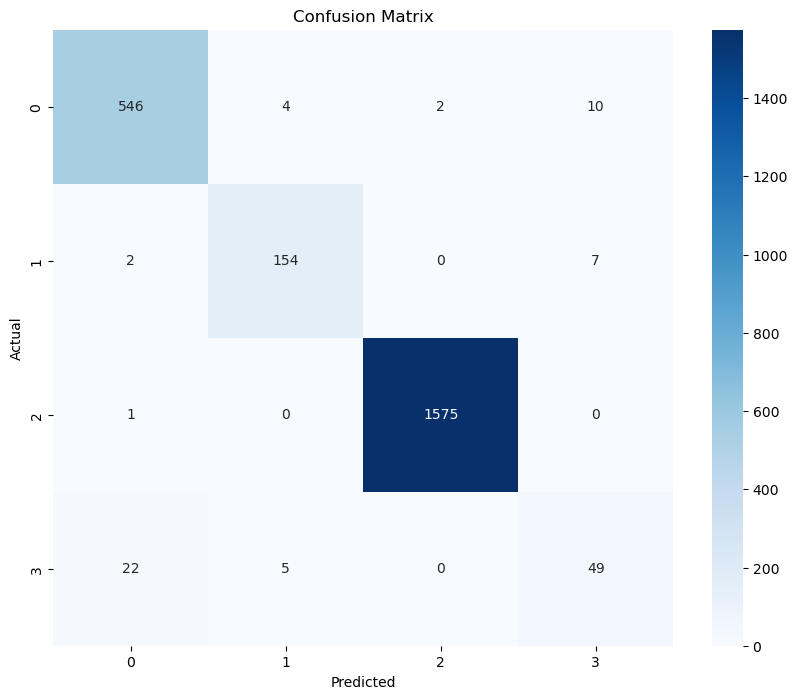

True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 0, Predicted Label: 3
True Label: 3, Predicted Label: 0
True Label: 1, Predicted Label: 3
True Label: 0, Predicted Label: 3
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 1, Predicted Label: 3
True Label: 0, Predicted Label: 3
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 1
True Label: 3, Predicted Label: 0
True Label: 0, Predicted Label: 1
True Label: 1, Predicted Label: 3
True Label: 0, Predicted Label: 1
True Label: 0, Predicted Label: 2
True Label: 0, Predicted Label: 3
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 0, Predicted Label: 3
True Label: 1, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 3, Predicted Label: 0
True Label: 0, Predicted Label: 3
True Label: 3, Predicted Label: 0
True Label: 3,

In [420]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Generate confusion matrix
cm = confusion_matrix(all_labels, all_predictions)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# Find misclassified examples
misclassified_indices = [idx for idx in range(len(all_labels)) if all_labels[idx] != all_predictions[idx]]

# Loop through some of the misclassified examples
for idx in misclassified_indices[:100]:  # Show first 100 misclassifications
    true_label = all_labels[idx]
    predicted_label = all_predictions[idx]
    print(f"True Label: {true_label}, Predicted Label: {predicted_label}")

In [428]:
def feature_ablation(model, X_val, y_val, metric=accuracy_score):
    baseline_score = metric(y_val, model.predict(X_val))
    importances = np.zeros(X_val.shape[1])

    for i in range(X_val.shape[1]):
        X_val_reduced = np.delete(X_val, i, axis=1)
        score = metric(y_val, model.predict(X_val_reduced))
        importances[i] = baseline_score - score
    
    return importances

# Example usage
importances = feature_ablation(model, X_val, y_val)
print("Feature importances:", importances)



import shap

# Define the SHAP explainer with the model's predict method
explainer = shap.KernelExplainer(lambda x: model.predict(x), y_train)

# Calculate SHAP values for the validation set
shap_values = explainer.shap_values(X_val)

# Plot SHAP values
shap.summary_plot(shap_values, X_val)

RuntimeError: output with shape [1, 512] doesn't match the broadcast shape [1, 6, 512]

In [418]:
import torch
import numpy as np
from sklearn.metrics import accuracy_score

def predict(model, X):
    model.eval()
    all_predictions = []
    with torch.no_grad():
        # Initialize lists for batched processing
        batch_sequences = []
        batch_lengths = []
        
        for seq in X:
            # Convert sequence to a PyTorch tensor
            seq_tensor = torch.tensor(np.array(seq, dtype=np.float32))
            batch_sequences.append(seq_tensor)
            batch_lengths.append(len(seq))
        
        # Pack sequences
        packed_sequences = nn.utils.rnn.pack_sequence(batch_sequences, enforce_sorted=False)
        
        # Prepare lengths tensor
        lengths_tensor = torch.tensor(batch_lengths, dtype=torch.long)
        
        # Perform prediction
        packed_output = model(packed_sequences, lengths_tensor)
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        
        # Get predictions from the last time step of each sequence
        idx = (lengths_tensor - 1).to(packed_output.data.device)
        predictions = output[torch.arange(output.size(0)), idx]
        
        _, predicted_classes = torch.max(predictions, 1)
        all_predictions.extend(predicted_classes.cpu().numpy())
    
    return np.array(all_predictions)

def permutation_importance(model, X, y, metric=accuracy_score):
    baseline_score = metric(y, predict(model, X))
    importances = np.zeros(X[0].shape[1])

    for i in range(X[0].shape[1]):
        X_permuted = []
        for seq in X:
            seq_permuted = seq.copy()
            np.random.shuffle(seq_permuted[:, i])
            X_permuted.append(seq_permuted)
        permuted_score = metric(y, predict(model, X_permuted))
        importances[i] = baseline_score - permuted_score
    
    return importances

# # Example usage
# importances = permutation_importance(model, X_val, y_val)
# print("Feature importances:", importances)


import shap

# Create a SHAP explainer
# explainer = shap.KernelExplainer(model.predict, X_train)
# shap_values = explainer.shap_values(X_val)

# # Plot SHAP values
# shap.summary_plot(shap_values, X_val)

from lime.lime_tabular import LimeTabularExplainer

# Create a LIME explainer
# explainer = LimeTabularExplainer(X_train, mode='classification', training_labels=y_train)
# idx = 0  # Index of the instance you want to explain
# exp = explainer.explain_instance(X_val[idx], model.predict_proba)

# Show the explanation
# exp.show_in_notebook()

def feature_ablation(model, X_val, y_val, metric=accuracy_score):
    baseline_score = metric(y_val, model.predict(X_val))
    importances = np.zeros(X_val.shape[1])

    for i in range(X_val.shape[1]):
        X_val_reduced = np.delete(X_val, i, axis=1)
        score = metric(y_val, model.predict(X_val_reduced))
        importances[i] = baseline_score - score
    
    return importances

# Example usage
importances = feature_ablation(model, X_val, y_val)
print("Feature importances:", importances)

# This is more complex and depends on the specific structure of your LSTM model.
# You would need to modify your model to return activations or hidden states.

def get_activations(model, data_loader):
    activations = []
    for packed_sequences, _, _ in data_loader:
        outputs, _ = model(packed_sequences)
        activations.append(outputs)
    
    return torch.cat(activations, dim=0).detach().numpy()

# Example usage
activations = get_activations(model, val_loader)


RuntimeError: output with shape [1, 512] doesn't match the broadcast shape [1, 6, 512]

# Training Notes:

**Normalization** has insignificant effect on model accuracy, but significant effect on training time.

**Training Accuracy** is less than Validation and Testing Accuracy only when data is resampled for class balancing

**Ragged Nested List** changes to methods to change `X` such that a single entry is a list of 1D ndarrays instead of a 2D array. 

**Padding** on ragged sequences yields 69% testing accuracy.

# Post Training Notes:

**Number of Epochs** decreases as more time points are included per sample

**Training Accuracy** increases as more time points are included per sample

**Validation Accuracy** increases as more time points are included per sample

**Testing Accuracy** increases as more time points are included per sample

**Balancing Data** decreases all accuracy. Hypothesis: Model changes too much for the underrepresented classes.

# Final Epoch Results Comparison

| Number of Entries | **Padded/Unbalanced Model** | **Padded/Balanced Model** |
|-------------------|-----------------------------|---------------------------|
| **1**             | **Epoch:** [40/50]          | **Epoch:** [18/50]        |
|                   | **Loss:** 0.0574            | **Loss:** 0.1218          |
|                   | **Accuracy:** 98.23%        | **Accuracy:** 95.61%      |
|                   | **Val Loss:** 0.0796        | **Val Loss:** 0.1203      |
|                   | **Val Accuracy:** 97.64%    | **Val Accuracy:** 96.42%  |
|                   | **Learning Rate:** 1e-05    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0790       | **Test Loss:** 0.0941     |
|                   | **Test Accuracy:** 97.60%   | **Test Accuracy:** 96.80% |
||||
| **2**             | **Epoch:** [34/50]          | **Epoch:** [16/50]        |
|                   | **Loss:** 0.0583            | **Loss:** 0.0150          |
|                   | **Accuracy:** 98.20%        | **Accuracy:** 99.64%      |
|                   | **Val Loss:** 0.0770        | **Val Loss:** 0.1237      |
|                   | **Val Accuracy:** 97.60%    | **Val Accuracy:** 97.47%  |
|                   | **Learning Rate:** 1e-07    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0690       | **Test Loss:** 0.0968     |
|                   | **Test Accuracy:** 98.06%   | **Test Accuracy:** 97.43% |
||||
| **3**             | **Epoch:** [28/50]          | **Epoch:** [14/50]        |
|                   | **Loss:** 0.0360            | **Loss:** 0.0085          |
|                   | **Accuracy:** 98.78%        | **Accuracy:** 99.86%      |
|                   | **Val Loss:** 0.0679        | **Val Loss:** 0.1346      |
|                   | **Val Accuracy:** 98.11%    | **Val Accuracy:** 97.47%  |
|                   | **Learning Rate:** 1e-05    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0743       | **Test Loss:** 0.0909     |
|                   | **Test Accuracy:** 97.90%   | **Test Accuracy:** 96.63% |
||||
| **4**             | **Epoch:** [33/50]          | **Epoch:** [13/50]        |
|                   | **Loss:** 0.0382            | **Loss:** 0.0071          |
|                   | **Accuracy:** 98.85%        | **Accuracy:** 99.87%      |
|                   | **Val Loss:** 0.0682        | **Val Loss:** 0.1237      |
|                   | **Val Accuracy:** 98.06%    | **Val Accuracy:** 97.56%  |
|                   | **Learning Rate:** 1e-06    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0599       | **Test Loss:** 0.0877     |
|                   | **Test Accuracy:** 97.94%   | **Test Accuracy:** 96.93% |
||||
| **5**             | **Epoch:** [33/50]          | **Epoch:** [12/50]        |
|                   | **Loss:** 0.0209            | **Loss:** 0.0089          |
|                   | **Accuracy:** 99.37%        | **Accuracy:** 99.85%      |
|                   | **Val Loss:** 0.0801        | **Val Loss:** 0.1479      |
|                   | **Val Accuracy:** 97.73%    | **Val Accuracy:** 97.10%  |
|                   | **Learning Rate:** 1e-05    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0725       | **Test Loss:** 0.1064     |
|                   | **Test Accuracy:** 97.73%   | **Test Accuracy:** 96.21% |
||||
| **6**             | **Epoch:** [23/50]          | **Epoch:** [13/50]        |
|                   | **Loss:** 0.0345            | **Loss:** 0.0033          |
|                   | **Accuracy:** 99.02%        | **Accuracy:** 99.95%      |
|                   | **Val Loss:** 0.0943        | **Val Loss:** 0.1495      |
|                   | **Val Accuracy:** 97.31%    | **Val Accuracy:** 97.39%  |
|                   | **Learning Rate:** 1e-05    | **Learning Rate:** 1e-05  |
|                   | **Test Loss:** 0.0635       | **Test Loss:** 0.0855     |
|                   | **Test Accuracy:** 98.23%   | **Test Accuracy:** 97.43% |


# Full Results

## Padded Model / Unbalanced

### Number of Entries = 1

- **Epoch:** [40/50]
- **Loss:** 0.0574
- **Accuracy:** 98.23%
- **Val Loss:** 0.0796
- **Val Accuracy:** 97.64%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0790
- **Test Accuracy:** 97.60%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9279    | 0.9843 | 0.9553   | 510     |
| 1     | 0.9615    | 0.9317 | 0.9464   | 161     |
| 2     | 0.9976    | 0.9982 | 0.9979   | 1644    |
| 3     | 0.7714    | 0.4355 | 0.5567   | 62      |

- **Accuracy:** 97.60%  
- **Macro Avg:** Precision = 0.9146, Recall = 0.8374, F1-Score = 0.8641  
- **Weighted Avg:** Precision = 0.9743, Recall = 0.9760, F1-Score = 0.9737

### Number of Entries = 2

- **Epoch:** [34/50]
- **Loss:** 0.0583
- **Accuracy:** 98.20%
- **Val Loss:** 0.0770
- **Val Accuracy:** 97.60%
- **Learning Rate:** 1e-07
- **Early Stopping**
- **Test Loss:** 0.0690
- **Test Accuracy:** 98.06%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9477    | 0.9795 | 0.9634   | 537     |
| 1     | 0.9346    | 0.9597 | 0.9470   | 149     |
| 2     | 0.9988    | 0.9988 | 0.9988   | 1627    |
| 3     | 0.8810    | 0.5781 | 0.6981   | 64      |

- **Accuracy:** 98.06%  
- **Macro Avg:** Precision = 0.9405, Recall = 0.8790, F1-Score = 0.9018  
- **Weighted Avg:** Precision = 0.9801, Recall = 0.9806, F1-Score = 0.9794

### Number of Entries = 3

- **Epoch:** [28/50]
- **Loss:** 0.0360
- **Accuracy:** 98.78%
- **Val Loss:** 0.0679
- **Val Accuracy:** 98.11%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0743
- **Test Accuracy:** 97.90%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9441    | 0.9765 | 0.9600   | 553     |
| 1     | 0.9437    | 0.9710 | 0.9571   | 138     |
| 2     | 0.9969    | 0.9988 | 0.9978   | 1609    |
| 3     | 0.9020    | 0.5974 | 0.7188   | 77      |

- **Accuracy:** 97.90%  
- **Macro Avg:** Precision = 0.9466, Recall = 0.8859, F1-Score = 0.9084  
- **Weighted Avg:** Precision = 0.9784, Recall = 0.9790, F1-Score = 0.9776

### Number of Entries = 4

- **Epoch:** [33/50]
- **Loss:** 0.0382
- **Accuracy:** 98.85%
- **Val Loss:** 0.0682
- **Val Accuracy:** 98.06%
- **Learning Rate:** 1e-06
- **Early Stopping**
- **Test Loss:** 0.0599
- **Test Accuracy:** 97.94%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9581    | 0.9634 | 0.9607   | 546     |
| 1     | 0.9636    | 0.9755 | 0.9695   | 163     |
| 2     | 0.9981    | 0.9988 | 0.9984   | 1603    |
| 3     | 0.7119    | 0.6462 | 0.6774   | 65      |

- **Accuracy:** 97.94%  
- **Macro Avg:** Precision = 0.9079, Recall = 0.8959, F1-Score = 0.9015  
- **Weighted Avg:** Precision = 0.9787, Recall = 0.9794, F1-Score = 0.9790

### Number of Entries = 5

- **Epoch:** [33/50]
- **Loss:** 0.0209
- **Accuracy:** 99.37%
- **Val Loss:** 0.0801
- **Val Accuracy:** 97.73%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0725
- **Test Accuracy:** 97.73%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9556    | 0.9663 | 0.9609   | 534     |
| 1     | 0.9557    | 0.9321 | 0.9437   | 162     |
| 2     | 0.9988    | 0.9988 | 0.9988   | 1617    |
| 3     | 0.6613    | 0.6406 | 0.6508   | 64      |

- **Accuracy:** 97.73%  
- **Macro Avg:** Precision = 0.8928, Recall = 0.8844, F1-Score = 0.8886  
- **Weighted Avg:** Precision = 0.9770, Recall = 0.9773, F1-Score = 0.9771

### Number of Entries = 6

- **Epoch:** [23/50]
- **Loss:** 0.0345
- **Accuracy:** 99.02%
- **Val Loss:** 0.0943
- **Val Accuracy:** 97.31%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0635
- **Test Accuracy:** 98.23%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9508    | 0.9767 | 0.9635   | 514     |
| 1     | 0.9560    | 0.9721 | 0.9640   | 179     |
| 2     | 0.9988    | 0.9982 | 0.9985   | 1627    |
| 3     | 0.8537    | 0.6140 | 0.7143   | 57      |

- **Accuracy:** 98.23%  
- **Macro Avg:** Precision = 0.9398, Recall = 0.8902, F1-Score = 0.9101  
- **Weighted Avg:** Precision = 0.9817, Recall = 0.9823, F1-Score = 0.9815


## Padded Model / Balanced

### Number of Entries = 1

- **Epoch:** [18/50]
- **Loss:** 0.1218
- **Accuracy:** 95.61%
- **Val Loss:** 0.1203
- **Val Accuracy:** 96.42%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0941
- **Test Accuracy:** 96.80%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9570    | 0.9142 | 0.9351   | 536     |
| 1     | 0.9193    | 0.9737 | 0.9457   | 152     |
| 2     | 0.9988    | 0.9975 | 0.9981   | 1614    |
| 3     | 0.5761    | 0.7067 | 0.6347   | 75      |

- **Accuracy:** 96.80%  
- **Macro Avg:** Precision = 0.8628, Recall = 0.8980, F1-Score = 0.8784  
- **Weighted Avg:** Precision = 0.9709, Recall = 0.9680, F1-Score = 0.9691

### Number of Entries = 2

- **Epoch:** [16/50]
- **Loss:** 0.0150
- **Accuracy:** 99.64%
- **Val Loss:** 0.1237
- **Val Accuracy:** 97.47%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0968
- **Test Accuracy:** 97.43%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9585    | 0.9363 | 0.9473   | 518     |
| 1     | 0.9602    | 0.9826 | 0.9713   | 172     |
| 2     | 0.9981    | 0.9994 | 0.9988   | 1615    |
| 3     | 0.6154    | 0.6667 | 0.6400   | 72      |

- **Accuracy:** 97.43%  
- **Macro Avg:** Precision = 0.8831, Recall = 0.8962, F1-Score = 0.8893  
- **Weighted Avg:** Precision = 0.9752, Recall = 0.9743, F1-Score = 0.9747

### Number of Entries = 3

- **Epoch:** [14/50]
- **Loss:** 0.0085
- **Accuracy:** 99.86%
- **Val Loss:** 0.1346
- **Val Accuracy:** 97.47%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0909
- **Test Accuracy:** 96.63%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9586    | 0.9123 | 0.9349   | 559     |
| 1     | 0.9299    | 0.9669 | 0.9481   | 151     |
| 2     | 0.9956    | 0.9994 | 0.9975   | 1593    |
| 3     | 0.5506    | 0.6622 | 0.6012   | 74      |

- **Accuracy:** 96.63%  
- **Macro Avg:** Precision = 0.8587, Recall = 0.8852, F1-Score = 0.8704  
- **Weighted Avg:** Precision = 0.9689, Recall = 0.9663, F1-Score = 0.9673

### Number of Entries = 4

- **Epoch:** [13/50]
- **Loss:** 0.0071
- **Accuracy:** 99.87%
- **Val Loss:** 0.1237
- **Val Accuracy:** 97.56%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0877
- **Test Accuracy:** 96.93%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9443    | 0.9354 | 0.9398   | 526     |
| 1     | 0.9828    | 0.9500 | 0.9661   | 180     |
| 2     | 0.9987    | 0.9994 | 0.9990   | 1578    |
| 3     | 0.6214    | 0.6882 | 0.6531   | 93      |

- **Accuracy:** 96.93%  
- **Macro Avg:** Precision = 0.8868, Recall = 0.8932, F1-Score = 0.8895  
- **Weighted Avg:** Precision = 0.9707, Recall = 0.9693, F1-Score = 0.9699

### Number of Entries = 5

- **Epoch:** [12/50]
- **Loss:** 0.0089
- **Accuracy:** 99.85%
- **Val Loss:** 0.1479
- **Val Accuracy:** 97.10%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.1064
- **Test Accuracy:** 96.21%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9476    | 0.8954 | 0.9208   | 545     |
| 1     | 0.9563    | 0.9503 | 0.9533   | 161     |
| 2     | 0.9981    | 0.9975 | 0.9978   | 1600    |
| 3     | 0.4854    | 0.7042 | 0.5747   | 71      |

- **Accuracy:** 96.21%  
- **Macro Avg:** Precision = 0.8468, Recall = 0.8869, F1-Score = 0.8616  
- **Weighted Avg:** Precision = 0.9684, Recall = 0.9621, F1-Score = 0.9645

### Number of Entries = 6

- **Epoch:** [13/50]
- **Loss:** 0.0033
- **Accuracy:** 99.95%
- **Val Loss:** 0.1495
- **Val Accuracy:** 97.39%
- **Learning Rate:** 1e-05
- **Early Stopping**
- **Test Loss:** 0.0855
- **Test Accuracy:** 97.43%

| Class | Precision | Recall | F1-Score | Support |
|-------|-----------|--------|----------|---------|
| 0     | 0.9699    | 0.9348 | 0.9520   | 552     |
| 1     | 0.9441    | 0.9713 | 0.9575   | 174     |
| 2     | 0.9975    | 0.9962 | 0.9968   | 1576    |
| 3     | 0.6630    | 0.8133 | 0.7305   | 75      |

- **Accuracy:** 97.43%  
- **Macro Avg:** Precision = 0.8936, Recall = 0.9289, F1-Score = 0.9092  
- **Weighted Avg:** Precision = 0.9766, Recall = 0.9743, F1-Score = 0.9751


In [439]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
from sklearn.metrics import classification_report, accuracy_score

# Prepare data for LSTM
def prepare_lstm_data(samples):
    X = []
    y = []
    lengths = []
    
    columns = samples[0].columns
    target_column = "Activity Label"
    input_columns = columns[columns != target_column]

    for sample in samples:
        X.append(sample[input_columns].to_numpy())
        y.append(sample[target_column].iloc[0])
        lengths.append(len(sample))
    
    return X, np.array(y), lengths

# Sort by length in descending order in DataLoader
def collate_fn(batch):
    batch.sort(key=lambda x: x[2], reverse=True)
    sequences, labels, lengths = zip(*batch)
    
    # Convert to PyTorch tensors
    sequences = [torch.tensor(seq, dtype=torch.float32) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    lengths = torch.tensor(lengths, dtype=torch.long)
    
    # Pack the sequences
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=True)
    
    return packed_sequences, labels, lengths

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y, lengths):
        self.X = X
        self.y = y
        self.lengths = lengths

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx], self.lengths[idx]

# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(0.3)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input, lengths):
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        
        # Forward propagate LSTM
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        
        # Unpack the sequence
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        
        # Apply dropout on the unpacked sequence
        output = self.dropout(output)
        
        # Decode the hidden state of the last time step for each sequence
        idx = (lengths - 1).to(packed_output.data.device)
        batch_size = len(lengths)
        out = output[torch.arange(batch_size), idx]
        
        out = self.fc(out)

        return out
    
    def predict(self, X):
        self.eval()
        all_predictions = []
        with torch.no_grad():
            for seq in X:
                # Convert sequence to a PyTorch tensor
                seq_tensor = torch.tensor(np.array(seq, dtype=np.float32)).unsqueeze(0)  # Add batch dimension
                
                # Perform prediction
                output = self(seq_tensor)
                
                # Get the predicted class
                _, predicted_class = torch.max(output, 1)
                all_predictions.append(predicted_class.item())
        
        return np.array(all_predictions)

######################
### Implementation ###
######################

# Prepare LSTM Data
X, y, lengths = prepare_lstm_data(longitudinal_data_frames)

# Normalizing the data
X = [np.array(seq, dtype=np.float32) for seq in X]
means = [np.mean(seq) for seq in X]
stds = [np.std(seq) for seq in X]
X = [(seq - mean) / std for seq, mean, std in zip(X, means, stds)]

# Split data into training, validation, and testing sets
X_train, X_test, y_train, y_test, lengths_train, lengths_test = train_test_split(X, y, lengths, test_size=0.3)
X_val, X_test, y_val, y_test, lengths_val, lengths_test = train_test_split(X_test, y_test, lengths_test, test_size=0.5)

# Create datasets
train_dataset = LongitudinalDataset(X_train, y_train, lengths_train)
val_dataset = LongitudinalDataset(X_val, y_val, lengths_val)
test_dataset = LongitudinalDataset(X_test, y_test, lengths_test)

# Create DataLoader without a collate_fn
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)

# Model, criterion, optimizer, and scheduler
input_size = X_train[0].shape[1]  # number of features from a single sequence entry
hidden_size = 128
num_layers = 2
output_size = len(np.unique(y))
model = LSTMClassifier(input_size, hidden_size, num_layers, output_size)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)

# Training loop with validation
num_epochs = 50
best_val_loss = float('inf')
early_stopping_patience = 10
patience_counter = 0

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    correct = 0
    total = 0
    for sequences, labels, lengths in train_loader:
        optimizer.zero_grad()
        sequences = torch.tensor(sequences[0], dtype=torch.float32).unsqueeze(0)  # Batch size 1
        labels = torch.tensor(labels, dtype=torch.long)
        
        outputs = model(sequences, lengths)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss /= len(train_loader)
    epoch_accuracy = 100 * correct / total

    # Validation
    model.eval()
    val_loss = 0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for sequences, labels, lengths in val_loader:
            sequences = torch.tensor(sequences[0], dtype=torch.float32).unsqueeze(0)
            labels = torch.tensor(labels, dtype=torch.long)
            
            outputs = model(sequences, lengths)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()
    
    val_loss /= len(val_loader)
    val_accuracy = 100 * val_correct / val_total

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%, Learning Rate: {scheduler.optimizer.param_groups[0]["lr"]}')
    
    # Step the scheduler
    scheduler.step(val_loss)

    # Early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1
        if patience_counter >= early_stopping_patience:
            print('Early stopping...')
            break

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Test the model
model.eval()
test_loss = 0
test_correct = 0
test_total = 0
all_labels = []
all_predictions = []
with torch.no_grad():
    for sequences, labels, lengths in test_loader:
        sequences = torch.tensor(sequences[0], dtype=torch.float32).unsqueeze(0)
        labels = torch.tensor(labels, dtype=torch.long)
        
        outputs = model(sequences, lengths)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        test_total += labels.size(0)
        test_correct += (predicted == labels).sum().item()
        all_labels.extend(labels.cpu().numpy())
        all_predictions.extend(predicted.cpu().numpy())

test_loss /= len(test_loader)
test_accuracy = 100 * test_correct / test_total

# Print accuracy and classification report
print(f'Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.2f}%')
print(classification_report(all_labels, all_predictions, digits=4))


To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


AttributeError: 'Tensor' object has no attribute 'batch_sizes'

# Stop.

In [249]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import resample

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Custom collate function to handle variable-length sequences
def collate_fn(batch):
    # Sort batch by sequence length in descending order
    batch.sort(key=lambda x: len(x[0]), reverse=True)
    
    sequences, labels = zip(*batch)
    lengths = [len(seq) for seq in sequences]
    
    sequences = [torch.tensor(np.array(seq, dtype=np.float32)) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    
    # Pack sequences
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=True)
    
    return packed_sequences, labels, lengths

# Create data loaders
train_dataset = LongitudinalDataset(X_train, y_train)
test_dataset = LongitudinalDataset(X_test, y_test)

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=collate_fn)

# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(0.3)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input):
        # Initialize hidden state with zeros
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        
        # Forward propagate LSTM
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        
        # Unpack the sequence
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        
        # Apply dropout on the unpacked sequence
        output = self.dropout(output)
        
        # Decode the hidden state of the last time step for each sequence
        idx = (torch.tensor(lengths) - 1).to(packed_input.data.device)
        out = output[torch.arange(output.size(0)), idx]
        
        out = self.fc(out)
        return out

# Initialize model parameters
input_size = X_train[0].shape[1]  # Number of features
hidden_size = 64
num_layers = 2
# output_size = len(np.unique(y_resampled))  # Use the resampled data's unique labels
output_size = len(np.unique(y))  # Use the resampled data's unique labels

model = LSTMClassifier(input_size, hidden_size, num_layers, output_size)

# Define loss and optimizer with weight regularization
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)

# Early stopping criteria
early_stopping_patience = 10
best_loss = float('inf')
patience_counter = 0

# Train the model
num_epochs = 50
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    correct = 0
    total = 0
    for packed_sequences, labels, lengths in train_loader:
        optimizer.zero_grad()
        outputs = model(packed_sequences)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
    
    epoch_loss /= len(train_loader)
    epoch_accuracy = 100 * correct / total
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%')
    
    # Early stopping
    if epoch_loss < best_loss:
        best_loss = epoch_loss
        patience_counter = 0
        torch.save(model.state_dict(), 'best_model.pth')
    else:
        patience_counter += 1
        if patience_counter >= early_stopping_patience:
            print('Early stopping...')
            break

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Evaluate the model
model.eval()
y_pred = []
with torch.no_grad():
    for packed_sequences, labels, lengths in test_loader:
        outputs = model(packed_sequences)
        _, predicted = torch.max(outputs.data, 1)
        y_pred.append(predicted.cpu().numpy())

# Convert predictions and labels to numpy arrays
y_pred = np.concatenate(y_pred)
y_test = np.array(y_test)

# Print accuracy and classification report
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=[str(label) for label in activity_encoder.classes_]))

# TODO: Use 1st time point by itself, or last to check padding

Epoch [1/50], Loss: 0.8921, Accuracy: 66.98%
Epoch [2/50], Loss: 0.7727, Accuracy: 71.83%
Epoch [3/50], Loss: 0.4640, Accuracy: 83.78%
Epoch [4/50], Loss: 0.3664, Accuracy: 86.86%
Epoch [5/50], Loss: 0.3262, Accuracy: 88.28%
Epoch [6/50], Loss: 0.3310, Accuracy: 88.23%
Epoch [7/50], Loss: 0.3189, Accuracy: 88.46%
Epoch [8/50], Loss: 0.3318, Accuracy: 88.06%
Epoch [9/50], Loss: 0.3022, Accuracy: 88.81%
Epoch [10/50], Loss: 0.3037, Accuracy: 88.83%
Epoch [11/50], Loss: 0.2910, Accuracy: 89.16%
Epoch [12/50], Loss: 0.2871, Accuracy: 89.20%
Epoch [13/50], Loss: 0.3132, Accuracy: 88.75%
Epoch [14/50], Loss: 0.3159, Accuracy: 88.51%
Epoch [15/50], Loss: 0.2902, Accuracy: 89.16%
Epoch [16/50], Loss: 0.3117, Accuracy: 88.60%
Epoch [17/50], Loss: 0.3129, Accuracy: 88.50%
Epoch [18/50], Loss: 0.2799, Accuracy: 89.65%
Epoch [19/50], Loss: 0.2942, Accuracy: 89.35%
Epoch [20/50], Loss: 0.2781, Accuracy: 89.74%
Epoch [21/50], Loss: 0.2903, Accuracy: 89.38%
Epoch [22/50], Loss: 0.2916, Accuracy: 89.4

In [ ]:
yo = next(iter(train_loader))
print(yo)

# TODO: Use Padding (Impute based off of last time point 'post') as baseline

(PackedSequence(data=tensor([[ 0.0000,  1.0811, -0.2434,  ...,  1.0000,  1.1143,  0.0000],
        [ 0.0000,  0.4010,  0.0666,  ...,  0.0000,  1.0954,  0.0000],
        [ 0.0000,  1.2335, -0.1975,  ...,  1.0000,  1.2532,  0.0000],
        ...,
        [ 0.2000,  1.1397,  0.1699,  ...,  0.0000,  1.1524,  0.0300],
        [ 1.0000,  0.4362,  0.3996,  ...,  0.0000,  1.0796,  0.2500],
        [ 0.7500,  0.2838,  0.3307,  ...,  0.0000,  1.1066,  0.1200]]), batch_sizes=tensor([64, 64, 64, 64, 64, 64]), sorted_indices=None, unsorted_indices=None), tensor([2, 2, 2, 2, 2, 2, 0, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 0, 2, 0,
        2, 2, 1, 2, 2, 2, 0, 2, 3, 2, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2,
        2, 2, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2, 1, 2, 2, 2]), [6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6])


# After Padding Data

Batch Size = 64

Epoch [50/50], Loss: 0.2766, Accuracy: 89.54%
Accuracy: 0.9006942983378918
              precision    recall  f1-score   support

           0       0.70      0.98      0.82      1079
           1       0.00      0.00      0.00       307
           2       0.99      1.00      1.00      3224
           3       0.00      0.00      0.00       143

    accuracy                           0.90      4753
   macro avg       0.42      0.49      0.45      4753
weighted avg       0.83      0.90      0.86      4753

# After Fixing Data...

## Min Entries = 2, Max Entries = 6, But only the first entry included in the model:

### Batch Size = 1:

Epoch [21/50], Loss: 0.8926, Accuracy: 67.51%
Epoch [22/50], Loss: 0.8915, Accuracy: 67.51%
Epoch [23/50], Loss: 0.8928, Accuracy: 67.51%
Epoch [24/50], Loss: 0.8922, Accuracy: 67.51%
Epoch [25/50], Loss: 0.8924, Accuracy: 67.51%
...
    accuracy                           0.68      4753
   macro avg       0.17      0.25      0.20      4753
weighted avg       0.47      0.68      0.56      4753


### Batch Size = 64:

Epoch [23/50], Loss: 0.2762, Accuracy: 90.05%
Epoch [24/50], Loss: 0.2720, Accuracy: 90.13%
Epoch [25/50], Loss: 0.2771, Accuracy: 90.06%
...
    accuracy                           0.91      4753
   macro avg       0.85      0.60      0.61      4753
weighted avg       0.91      0.91      0.88      4753

### Min and Max Entries = 1

Epoch [50/50], Loss: 0.1894, Accuracy: 93.31%
Accuracy: 0.9396157770974755
              precision    recall  f1-score   support

           0       0.82      0.94      0.88      5012
           1       0.76      0.56      0.65      1478
           2       1.00      1.00      1.00     15348
           3       0.97      0.43      0.60       701

    accuracy                           0.94     22539
   macro avg       0.89      0.73      0.78     22539
weighted avg       0.94      0.94      0.94     22539

### Min and Max Entries = 2

Epoch [28/50], Loss: 0.2171, Accuracy: 92.44%
Early stopping...
Accuracy: 0.9216805464583139
              precision    recall  f1-score   support

           0       0.75      0.97      0.84      2305
           1       0.00      0.00      0.00       593
           2       0.99      1.00      1.00      7505
           3       0.99      0.36      0.53       284

    accuracy                           0.92     10687
   macro avg       0.68      0.58      0.59     10687
weighted avg       0.88      0.92      0.90     10687


### Min and Max Entries = 6

Epoch [50/50], Loss: 0.1814, Accuracy: 93.96%
Accuracy: 0.9393268379096545
              precision    recall  f1-score   support

           0       0.82      0.93      0.87       493
           1       0.68      0.53      0.59       125
           2       1.00      0.99      0.99      1578
           3       0.91      0.48      0.63        62

    accuracy                           0.94      2258
   macro avg       0.85      0.73      0.77      2258
weighted avg       0.94      0.94      0.94      2258


### Min and Max Entries = 10

Epoch [50/50], Loss: 0.2114, Accuracy: 93.91%
Accuracy: 0.9494584837545126
              precision    recall  f1-score   support

           0       0.88      0.96      0.92       249
           1       0.68      0.48      0.57        27
           2       0.99      1.00      1.00       534
           3       1.00      0.10      0.17        21

    accuracy                           0.95       831
   macro avg       0.89      0.64      0.66       831
weighted avg       0.95      0.95      0.94       831


In [ ]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import resample

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Custom collate function to handle variable-length sequences
def collate_fn(batch):
    batch.sort(key=lambda x: len(x[0]), reverse=True)
    sequences, labels = zip(*batch)
    lengths = [len(seq) for seq in sequences]
    sequences = [torch.tensor(np.array(seq, dtype=np.float32)) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=True)
    return packed_sequences, labels, lengths

# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(0.3)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input, lengths):
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        output = self.dropout(output)
        idx = (torch.tensor(lengths) - 1).to(packed_input.data.device)
        out = output[torch.arange(output.size(0)), idx]
        out = self.fc(out)
        return out

def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=50):
    early_stopping_patience = 10
    best_loss = float('inf')
    patience_counter = 0

    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0
        correct = 0
        total = 0
        for packed_sequences, labels, lengths in train_loader:
            optimizer.zero_grad()
            outputs = model(packed_sequences, lengths)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        epoch_loss /= len(train_loader)
        epoch_accuracy = 100 * correct / total

        # Validation phase
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0
        with torch.no_grad():
            for packed_sequences, labels, lengths in val_loader:
                outputs = model(packed_sequences, lengths)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()

        val_loss /= len(val_loader)
        val_accuracy = 100 * val_correct / val_total

        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')

        # Early stopping
        if val_loss < best_loss:
            best_loss = val_loss
            patience_counter = 0
            torch.save(model.state_dict(), 'best_model.pth')
        else:
            patience_counter += 1
            if patience_counter >= early_stopping_patience:
                print('Early stopping...')
                break

# Apply K-Fold Cross-Validation
skf = StratifiedKFold(n_splits=5)
fold = 1
for train_index, val_index in skf.split(X, y):
    print(f'Fold {fold}')
    X_train_fold, X_val_fold = X[train_index], X[val_index]
    y_train_fold, y_val_fold = y[train_index], y[val_index]

    train_dataset = LongitudinalDataset(X_train_fold, y_train_fold)
    val_dataset = LongitudinalDataset(X_val_fold, y_val_fold)

    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, collate_fn=collate_fn)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

    model = LSTMClassifier(input_size, hidden_size, num_layers, output_size)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-6)

    train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=50)
    fold += 1

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Evaluate the model on the test set
test_dataset = LongitudinalDataset(X_test, y_test)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

model.eval()
y_pred = []
with torch.no_grad():
    for packed_sequences, labels, lengths in test_loader:
        outputs = model(packed_sequences, lengths)
        _, predicted = torch.max(outputs.data, 1)
        y_pred.append(predicted.cpu().numpy())

# Convert predictions and labels to numpy arrays
y_pred = np.concatenate(y_pred)
y_test = np.array(y_test)

# Print accuracy and classification report
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=[str(label) for label in activity_encoder.classes_]))

Fold 1
Epoch [1/50], Loss: 0.9200, Accuracy: 68.20%, Val Loss: 0.8303, Val Accuracy: 70.17%
Epoch [2/50], Loss: 0.7571, Accuracy: 70.06%, Val Loss: 0.7999, Val Accuracy: 70.17%
Epoch [3/50], Loss: 0.6498, Accuracy: 74.90%, Val Loss: 0.5118, Val Accuracy: 86.91%
Epoch [4/50], Loss: 0.4814, Accuracy: 84.95%, Val Loss: 0.4579, Val Accuracy: 88.97%
Epoch [5/50], Loss: 0.3834, Accuracy: 88.84%, Val Loss: 0.2637, Val Accuracy: 91.63%
Epoch [6/50], Loss: 0.3379, Accuracy: 89.60%, Val Loss: 0.3992, Val Accuracy: 89.04%
Epoch [7/50], Loss: 0.3047, Accuracy: 90.63%, Val Loss: 0.3142, Val Accuracy: 89.90%
Epoch [8/50], Loss: 0.2732, Accuracy: 91.29%, Val Loss: 0.2376, Val Accuracy: 91.69%
Epoch [9/50], Loss: 0.2718, Accuracy: 91.34%, Val Loss: 0.2646, Val Accuracy: 91.63%
Epoch [10/50], Loss: 0.2967, Accuracy: 90.81%, Val Loss: 0.2435, Val Accuracy: 91.83%
Epoch [11/50], Loss: 0.2813, Accuracy: 91.36%, Val Loss: 0.2318, Val Accuracy: 91.76%
Epoch [12/50], Loss: 0.2497, Accuracy: 91.38%, Val Loss:

/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitaliz

In [ ]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.metrics import classification_report, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import resample

# Custom Dataset class
class LongitudinalDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Custom collate function to handle variable-length sequences
def collate_fn(batch):
    batch.sort(key=lambda x: len(x[0]), reverse=True)
    sequences, labels = zip(*batch)
    lengths = [len(seq) for seq in sequences]
    sequences = [torch.tensor(np.array(seq, dtype=np.float32)) for seq in sequences]
    labels = torch.tensor(labels, dtype=torch.long)
    packed_sequences = nn.utils.rnn.pack_sequence(sequences, enforce_sorted=True)
    return packed_sequences, labels, lengths

# Define the LSTM model with Dropout and Weight Regularization
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_rate=0.3):
        super(LSTMClassifier, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers=num_layers, batch_first=True)
        self.dropout = nn.Dropout(dropout_rate)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, packed_input, lengths):
        h0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        c0 = torch.zeros(self.num_layers, packed_input.batch_sizes[0], self.hidden_size).to(packed_input.data.device)
        packed_output, (h_n, c_n) = self.lstm(packed_input, (h0, c0))
        output, _ = nn.utils.rnn.pad_packed_sequence(packed_output, batch_first=True)
        output = self.dropout(output)
        idx = (torch.tensor(lengths) - 1).to(packed_input.data.device)
        out = output[torch.arange(output.size(0)), idx]
        out = self.fc(out)
        return out

# Function to train the model
def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=50):
    early_stopping_patience = 10
    best_loss = float('inf')
    patience_counter = 0

    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0
        correct = 0
        total = 0
        for packed_sequences, labels, lengths in train_loader:
            optimizer.zero_grad()
            outputs = model(packed_sequences, lengths)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        epoch_loss /= len(train_loader)
        epoch_accuracy = 100 * correct / total

        # Validation phase
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0
        with torch.no_grad():
            for packed_sequences, labels, lengths in val_loader:
                outputs = model(packed_sequences, lengths)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()

        val_loss /= len(val_loader)
        val_accuracy = 100 * val_correct / val_total

        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%')

        # Early stopping
        if val_loss < best_loss:
            best_loss = val_loss
            patience_counter = 0
            torch.save(model.state_dict(), 'best_model.pth')
        else:
            patience_counter += 1
            if patience_counter >= early_stopping_patience:
                print('Early stopping...')
                break

# Apply Nested Cross-Validation for Hyperparameter Tuning
outer_cv = StratifiedKFold(n_splits=5)
inner_cv = StratifiedKFold(n_splits=3)
param_grid = {
    'hidden_size': [16, 32, 64, 128],
    'num_layers': [1, 2, 3, 4],
    'dropout_rate': [0.1, 0.3, 0.5],
    'weight_decay': [1e-4, 1e-5, 1e-6]
}

fold = 1
for train_index, val_index in outer_cv.split(X, y):
    print(f'Fold {fold}')
    X_train_fold, X_val_fold = X[train_index], X[val_index]
    y_train_fold, y_val_fold = y[train_index], y[val_index]

    best_params = None
    best_val_accuracy = 0

    for hidden_size in param_grid['hidden_size']:
        for num_layers in param_grid['num_layers']:
            for dropout_rate in param_grid['dropout_rate']:
                for weight_decay in param_grid['weight_decay']:
                    val_accuracies = []
                    for inner_train_index, inner_val_index in inner_cv.split(X_train_fold, y_train_fold):
                        X_inner_train, X_inner_val = X_train_fold[inner_train_index], X_train_fold[inner_val_index]
                        y_inner_train, y_inner_val = y_train_fold[inner_train_index], y_train_fold[inner_val_index]

                        train_dataset = LongitudinalDataset(X_inner_train, y_inner_train)
                        val_dataset = LongitudinalDataset(X_inner_val, y_inner_val)

                        train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, collate_fn=collate_fn)
                        val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

                        model = LSTMClassifier(input_size, hidden_size, num_layers, output_size, dropout_rate)
                        criterion = nn.CrossEntropyLoss()
                        optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=weight_decay)

                        train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=20)
                        
                        model.eval()
                        val_correct = 0
                        val_total = 0
                        with torch.no_grad():
                            for packed_sequences, labels, lengths in val_loader:
                                outputs = model(packed_sequences, lengths)
                                _, predicted = torch.max(outputs.data, 1)
                                val_total += labels.size(0)
                                val_correct += (predicted == labels).sum().item()
                        val_accuracy = 100 * val_correct / val_total
                        val_accuracies.append(val_accuracy)

                    avg_val_accuracy = np.mean(val_accuracies)
                    if avg_val_accuracy > best_val_accuracy:
                        best_val_accuracy = avg_val_accuracy
                        best_params = (hidden_size, num_layers, dropout_rate, weight_decay)

    hidden_size, num_layers, dropout_rate, weight_decay = best_params
    train_dataset = LongitudinalDataset(X_train_fold, y_train_fold)
    val_dataset = LongitudinalDataset(X_val_fold, y_val_fold)

    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, collate_fn=collate_fn)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

    model = LSTMClassifier(input_size, hidden_size, num_layers, output_size, dropout_rate)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=weight_decay)

    train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=50)
    fold += 1

# Load the best model
model.load_state_dict(torch.load('best_model.pth'))

# Evaluate the model on the test set
test_dataset = LongitudinalDataset(X_test, y_test)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False, collate_fn=collate_fn)

model.eval()
y_pred = []
with torch.no_grad():
    for packed_sequences, labels, lengths in test_loader:
        outputs = model(packed_sequences, lengths)
        _, predicted = torch.max(outputs.data, 1)
        y_pred.append(predicted.cpu().numpy())

# Convert predictions and labels to numpy arrays
y_pred = np.concatenate(y_pred)
y_test = np.array(y_test)

# Print accuracy and classification report
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=[str(label) for label in activity_encoder.classes_]))


Fold 1
Epoch [1/20], Loss: 1.3212, Accuracy: 41.90%, Val Loss: 1.1222, Val Accuracy: 70.20%
Epoch [2/20], Loss: 1.0213, Accuracy: 70.19%, Val Loss: 0.9285, Val Accuracy: 70.20%
Epoch [3/20], Loss: 0.9064, Accuracy: 70.19%, Val Loss: 0.8657, Val Accuracy: 70.20%
Epoch [4/20], Loss: 0.8641, Accuracy: 70.19%, Val Loss: 0.8339, Val Accuracy: 70.20%
Epoch [5/20], Loss: 0.8471, Accuracy: 70.19%, Val Loss: 0.8237, Val Accuracy: 70.20%
Epoch [6/20], Loss: 0.8413, Accuracy: 70.19%, Val Loss: 0.8222, Val Accuracy: 70.20%
Epoch [7/20], Loss: 0.8362, Accuracy: 70.19%, Val Loss: 0.8209, Val Accuracy: 70.20%
Epoch [8/20], Loss: 0.8376, Accuracy: 70.19%, Val Loss: 0.8209, Val Accuracy: 70.20%
Epoch [9/20], Loss: 0.8382, Accuracy: 70.19%, Val Loss: 0.8208, Val Accuracy: 70.20%
Epoch [10/20], Loss: 0.8447, Accuracy: 70.19%, Val Loss: 0.8215, Val Accuracy: 70.20%
Epoch [11/20], Loss: 0.8352, Accuracy: 70.19%, Val Loss: 0.8218, Val Accuracy: 70.20%
Epoch [12/20], Loss: 0.8386, Accuracy: 70.19%, Val Loss:

KeyboardInterrupt: 

In [ ]:
print(f'Best Overall Parameters: Hidden Size={best_params[0]}, Num Layers={best_params[1]}, Dropout Rate={best_params[2]}, Weight Decay={best_params[3]}')

Best Overall Parameters: Hidden Size=64, Num Layers=2, Dropout Rate=0.3, Weight Decay=1e-05


In [ ]:
print(X.shape)
print(type(X))
idx = 12969
print(len(longitudinal_data_frames))
print(longitudinal_data_frames[idx])
# print(X[idx])

(15841,)
<class 'numpy.ndarray'>
15841
       Time  Frontal Accel  Vertical Accel  Lateral Accel  Antenna ID  RSSI  \
39109  0.00       0.060972         0.98526       0.077541           4 -56.5   
39110  0.02       0.060972         0.98526       0.077541           4 -56.5   
39111  0.07       0.060972         0.98526       0.077541           4 -56.5   
39112  0.12       0.060972         0.98526       0.077541           4 -56.5   
39113  0.14       0.060972         0.98526       0.077541           4 -56.5   
39114  0.20       0.060972         0.98526       0.077541           4 -56.5   

        Phase  Frequency  Activity Label Patient ID  Gender  Total Accel  \
39109  5.1849     920.25               0         44       1     0.990186   
39110  5.1849     920.25               0         44       1     0.990186   
39111  5.1849     920.25               0         44       1     0.990186   
39112  5.1849     920.25               0         44       1     0.990186   
39113  5.1849     920.25   

In [ ]:
# Check that all labels are included in the training and test sets
print(np.unique(y_train))
print(np.unique(y_test))

# Check distribution of labels
print("Training class distribution:", np.bincount(y_train))
print("Testing class distribution:", np.bincount(y_test))

#TODO: Next check how resampling is done
print("Training class distribution:", np.bincount(X_train[0, :, :]))
print("Testing class distribution:", np.bincount(X_test[0, :, :]))

[0 1 2 3]
[0 1 2 3]
Training class distribution: [2249 2252 2261 2268]
Testing class distribution: [976 973 964 957]
tensor([0.7762, 1.1045, 0.4010,  ..., 0.3189, 0.7528, 1.0107])


ValueError: object too deep for desired array

In [ ]:
# Check class distribution
class_counts = np.bincount(y)
print("Class distribution:", class_counts)


# Separate classes
classes = np.unique(y)
X_resampled, y_resampled = [], []
for cls in classes:
    X_cls, y_cls = X[y == cls], y[y == cls]
    X_cls_resampled, y_cls_resampled = resample(X_cls, y_cls, replace=True, n_samples=X.shape[0] // len(classes), random_state=42)
    X_resampled.append(X_cls_resampled)
    y_resampled.append(y_cls_resampled)
X_resampled = np.vstack(X_resampled)
y_resampled = np.hstack(y_resampled)

# Check class distribution after resampling
print("Class distribution after resampling:", np.bincount(y_resampled))

Class distribution: [2815  835 8813  440]
Class distribution after resampling: [3225 3225 3225 3225]


In [ ]:
from sklearn.utils.class_weight import compute_class_weight

# Compute class weights
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y), y=y)
class_weights = torch.tensor(class_weights, dtype=torch.float32)

# Define the LSTM model with class weights
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LSTMClassifier, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(1, x.size(0), hidden_size).to(x.device)
        c0 = torch.zeros(1, x.size(0), hidden_size).to(x.device)
        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])
        return out

input_size = X_train.shape[2]
hidden_size = 50
output_size = len(np.unique(y))

model = LSTMClassifier(input_size, hidden_size, output_size)

# Define loss and optimizer with class weights
criterion = nn.CrossEntropyLoss(weight=class_weights.to(X_train.device))
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [ ]:
# Train the model
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    for X_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = model(X_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Evaluate the model
model.eval()
y_pred = []
with torch.no_grad():
    for X_batch, _ in test_loader:
        outputs = model(X_batch)
        _, predicted = torch.max(outputs.data, 1)
        y_pred.append(predicted.item())


Epoch [1/10], Loss: 0.3290
Epoch [2/10], Loss: 0.3529
Epoch [3/10], Loss: 0.6880
Epoch [4/10], Loss: 0.3776
Epoch [5/10], Loss: 1.5375
Epoch [6/10], Loss: 1.6618
Epoch [7/10], Loss: 0.3133
Epoch [8/10], Loss: 0.3705
Epoch [9/10], Loss: 0.3786
Epoch [10/10], Loss: 1.4755


AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

In [ ]:
# Convert predictions and labels to numpy arrays
y_pred = np.array(y_pred)
y_test = np.array(y_test)

# Print accuracy and classification report
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred, target_names=[str(label) for label in activity_encoder.classes_]))

Accuracy: 0.6832859726168948
              precision    recall  f1-score   support

           1       0.00      0.00      0.00       837
           2       0.00      0.00      0.00       261
           3       0.68      1.00      0.81      2645
           4       0.00      0.00      0.00       128

    accuracy                           0.68      3871
   macro avg       0.17      0.25      0.20      3871
weighted avg       0.47      0.68      0.55      3871



/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/opt/anaconda3/envs/LongDataAlgDev/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitaliz